microtext.py from https://github.com/SenticNet/microtext-normalization

In [26]:
import regex as re
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import nltk
from nltk.tokenize import word_tokenize
from nltk.sentiment import SentimentIntensityAnalyzer
# Download NLTK resources if not already downloaded
# nltk.download('punkt')
# nltk.download('vader_lexicon')

# from senticnet.senticnet import SenticNet
from microtext import microtext

from textblob import TextBlob

In [13]:
# sia = SentimentIntensityAnalyzer()
# sia.polarity_scores('you')

{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

In [72]:
custom_palette = {'Neutral': 'grey', 'Positive': 'green', 'Negative': 'red'}
def preprocess(df, moderator=None, text_col='body'):
    df_clean = df[['author', text_col]]
    df_clean = df_clean.dropna(subset=[text_col])
    if moderator:
        df_clean = df_clean[df_clean['author'] != moderator]
    df_clean[text_col] = df_clean[text_col].apply(lambda x: x.replace('\n', ' ') if not isinstance(x, float) else x)
    return df_clean

def nltk_polarity(df_clean, text_col='body'):
    sia = SentimentIntensityAnalyzer()
#     df_clean["NLTK Polarity Scores"] = df_clean[text_col].apply(lambda x: sia.polarity_scores(x))
#     df_clean["NLTK Compound Score"] = df_clean["NLTK Polarity Scores"].apply(lambda x: x['compound'])

    df_clean["NLTK Compound Score"] = df_clean[text_col].apply(lambda x: sia.polarity_scores(x)['compound'])
    df_clean["NLTK Polarity"] = df_clean["NLTK Compound Score"].apply(lambda x: 'Neutral' if x == 0 else 
                                                                      ('Positive' if x > 0 else 'Negative'))
    return df_clean

# def nltk_score_distribution(df_clean):
#     plt.figure(figsize=(10, 6))
#     df_clean["NLTK Compound Score"].plot(kind='hist', bins=100, color='skyblue', edgecolor='black')
#     plt.title('Distribution of Sentiment Compound Scores')
#     plt.xlabel('NLTK Compound Score')
#     plt.ylabel('Frequency')
#     plt.grid(True)
#     plt.show()
    
def nltk_score_distribution(df_clean, name=''):
#     neg_count = (df_clean["NLTK Compound Score"] < 0).sum()
#     neu_count = (df_clean["NLTK Compound Score"] == 0).sum()
#     pos_count = (df_clean["NLTK Compound Score"] > 0).sum()

    # Plotting
    plt.figure(figsize=(10, 6))
#     plt.bar(['Negative', 'Neutral', 'Positive'], [neg_count, neu_count, pos_count], color=['red', 'gray', 'green'])
    ax = sns.countplot(data=df_clean, x='NLTK Polarity', order=['Negative', 'Neutral', 'Positive'], palette=custom_palette)
    ax.bar_label(ax.containers[0])
    plt.title('Distribution of NLTK Polarity - ' + name)
    plt.xlabel('NLTK Polarity')
    plt.ylabel('Count')
    plt.grid(True)
    plt.show()
    
    
def textBlob_subjectivity_polarity(df_clean, text_col='body'):
    df_clean['TextBlob Subjectivity'] = df_clean[text_col].apply(lambda x: 'Opinionated' 
                                                                 if TextBlob(x).sentiment.subjectivity > 0.1
                                                                 else 'Neutral')
    
    df_clean['TextBlob Polarity'] = df_clean.apply(lambda row: TextBlob(row[text_col]).sentiment.polarity 
                                                   if row['TextBlob Subjectivity'] == 'Opinionated' else 'Neutral', axis=1)
    
    df_clean['TextBlob Polarity'] = df_clean['TextBlob Polarity'].apply(lambda x: ('Positive' if x > 0 else 'Negative')
                                                                       if isinstance(x, float)
                                                                       else x)
    return df_clean

def textBlob_score_distribution(df_clean, name=''):
    plt.figure(figsize=(10, 6))
    ax = sns.countplot(data=df_clean, x='TextBlob Polarity', order=['Negative', 'Neutral', 'Positive'], palette=custom_palette)
    ax.bar_label(ax.containers[0])
    plt.title('Distribution of TextBlob Polarity - ' + name)
    plt.xlabel('TextBlob Polarity')
    plt.ylabel('Count')
    plt.grid(True)
    plt.show()
    
def polarity_distribution_comparison(df_clean, name=''):
    df = df_clean[['NLTK Polarity', 'TextBlob Polarity']]
    plt.figure(figsize=(10, 6))
    ax = sns.countplot(data=pd.melt(df), x="value", hue="variable", order=['Negative', 'Neutral', 'Positive'])
    for container in ax.containers:
        ax.bar_label(container)
    plt.title('Comparison of Polarity Distributions - ' + name)
    plt.xlabel('Polarity')
    plt.ylabel('Count')
    plt.grid(True)
    plt.legend()
    plt.show()

In [ ]:
def load_keys(filename):
    with open(filename) as f:
        keys = json.load(f)
    return keys

keys = load_keys('sentic_apis.json')

# def sentic_polarity(keys):
#     #capacity limit for our server is 8000 characters
#     key = keys['polarity classification']
#     text = text.replace('&', ':').replace('#', ':').replace(';', ':').replace('{', ':').replace('}', ':')
#     url = "sentic.net/api/en/{key}.py?text={text}"

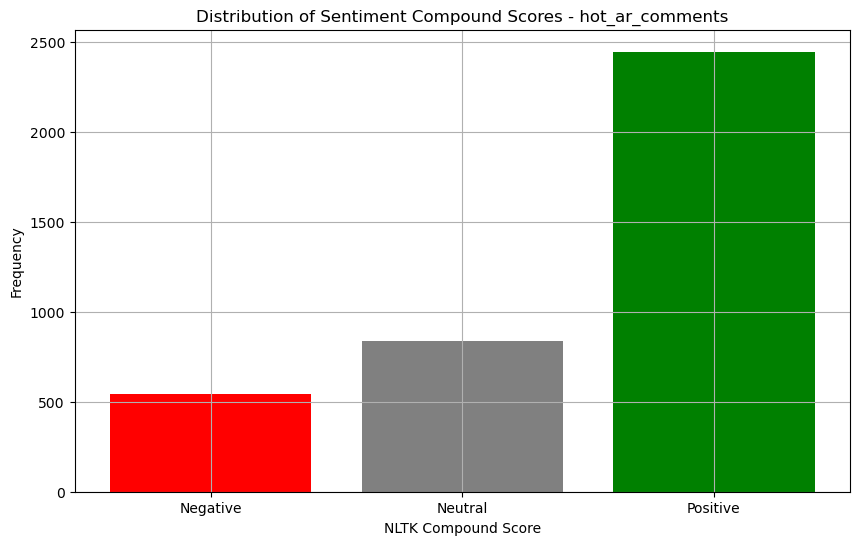

In [30]:
hot_ar_comments = pd.read_csv('hot_ar_comments.csv')
hot_ar_comments_clean = preprocess(hot_ar_comments, 'AutoModerator')
hot_ar_comments_clean = nltk_polarity(hot_ar_comments_clean)
nltk_score_distribution(hot_ar_comments_clean, 'hot_ar_comments')

In [76]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
# hot_ar_comments_clean

In [52]:
# Reset pandas options
pd.reset_option('display.max_rows')
pd.reset_option('display.max_colwidth')

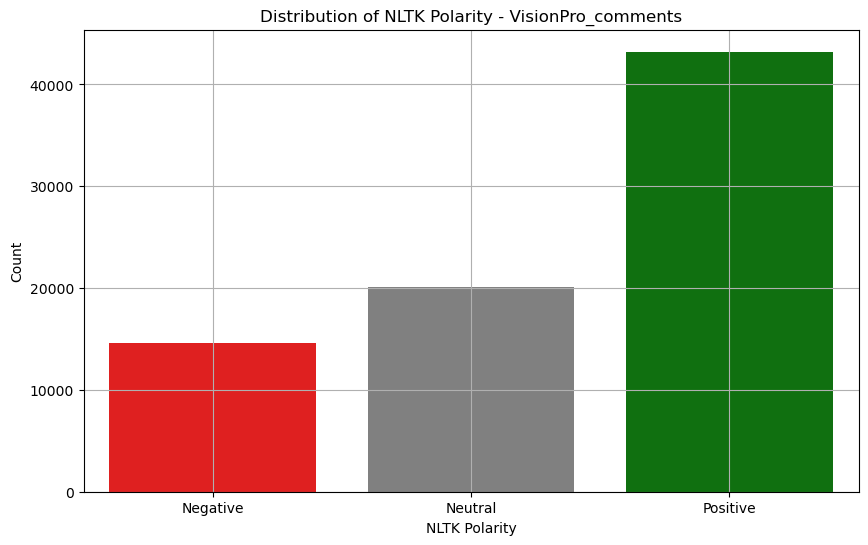

In [31]:
VisionPro_comments = pd.read_csv('VisionPro_comments.csv')
VisionPro_comments_clean = preprocess(VisionPro_comments)
VisionPro_comments_clean = nltk_polarity(VisionPro_comments_clean)
nltk_score_distribution(VisionPro_comments_clean, 'VisionPro_comments' )

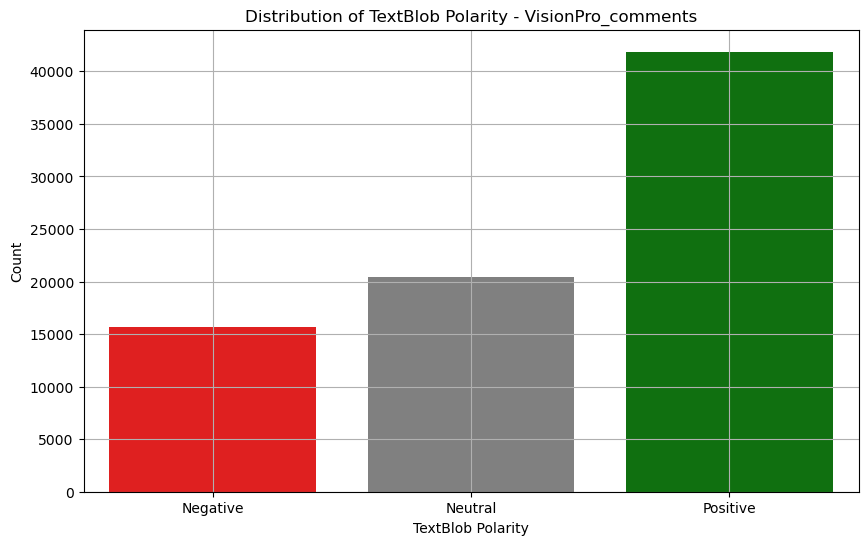

,author,body,TextBlob Subjectivity,TextBlob Polarity,NLTK Compound Score,NLTK Polarity
0,SoSKatan,All I see is a blonde brunette redhead.,Neutral,Neutral,0.0000,Neutral
3,xpr60,Did you make this through RealityKit?,Neutral,Neutral,0.0000,Neutral
4,ravedog,0.99 or 1.99 . . . Profit,Neutral,Neutral,0.4404,Positive
8,Odium-Squared,$12.99? Ouch…,Neutral,Neutral,0.0000,Neutral
9,warrior178,$13… way overpriced my guy. You’ve posted this here before.,Neutral,Neutral,0.0000,Neutral
12,Readdit_1,This is the beer mug iPhone app of the AVP,Neutral,Neutral,0.0000,Neutral
21,GreenLanturn,Congrats my dude! (Inb4 /u/underbyte accuses you of plagiarizing the code from the Matrix),Neutral,Neutral,0.3164,Positive
22,KeyPhotojournalist96,"Insta but at 99c. Otherwise, forget it.",Neutral,Neutral,-0.3291,Negative
26,outcoldman,"Just made a video recording of the Matrix demo in my house, used Owl3D to make it spatial video, and published it on ImmersiShare - https://loshadki.app/immersishare/",Neutral,Neutral,0.0000,Neutral
28,pumpuppthevolume,next they fire and u stop the bullets by lifting your hand ✋️,Neutral,Neutral,-0.1027,Negative


In [42]:
VisionPro_comments_clean = textBlob_subjectivity_polarity(VisionPro_comments_clean)
textBlob_score_distribution(VisionPro_comments_clean, 'VisionPro_comments')
# VisionPro_comments_clean[VisionPro_comments_clean['TextBlob Subjectivity'] == 'Neutral']

In [54]:
VisionPro_comments_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 77916 entries, 0 to 77916
Data columns (total 6 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   author                 75498 non-null  object 
 1   body                   77916 non-null  object 
 2   TextBlob Subjectivity  77916 non-null  object 
 3   TextBlob Polarity      77916 non-null  object 
 4   NLTK Compound Score    77916 non-null  float64
 5   NLTK Polarity          77916 non-null  object 
dtypes: float64(1), object(5)
memory usage: 6.2+ MB


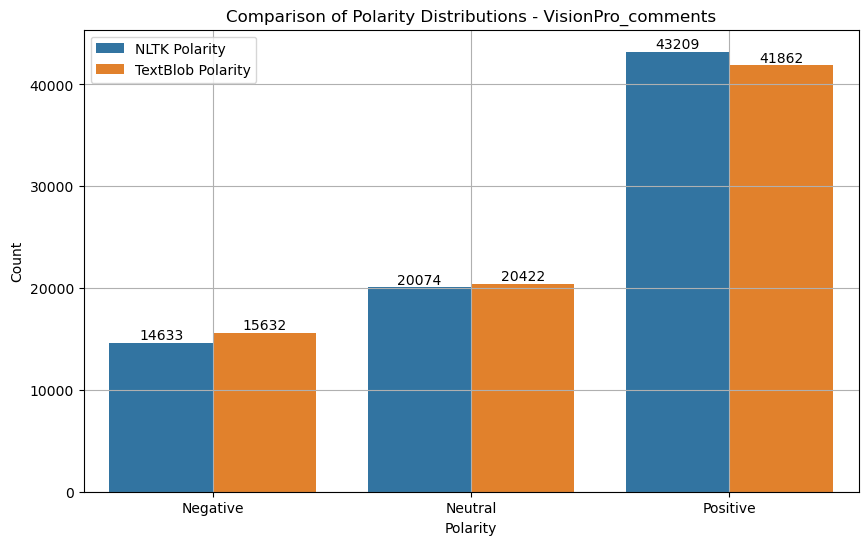

In [73]:
polarity_distribution_comparison(VisionPro_comments_clean, 'VisionPro_comments')

In [33]:
# VisionPro_comments_clean = bert_polarity(VisionPro_comments_clean)
# bert_score_distribution(VisionPro_comments_clean, 'VisionPro_comments' )

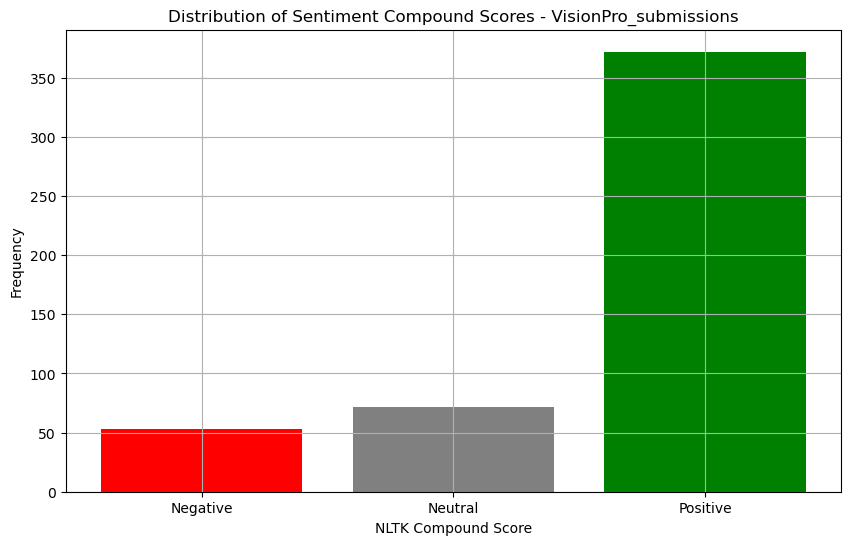

In [39]:
VisionPro_submissions = pd.read_csv('VisionPro_submissions.csv')
VisionPro_submissions_clean = preprocess(VisionPro_submissions, text_col='selftext')
VisionPro_submissions_clean = nltk_polarity(VisionPro_submissions_clean, text_col='selftext')
nltk_score_distribution(VisionPro_submissions_clean, 'VisionPro_submissions' )

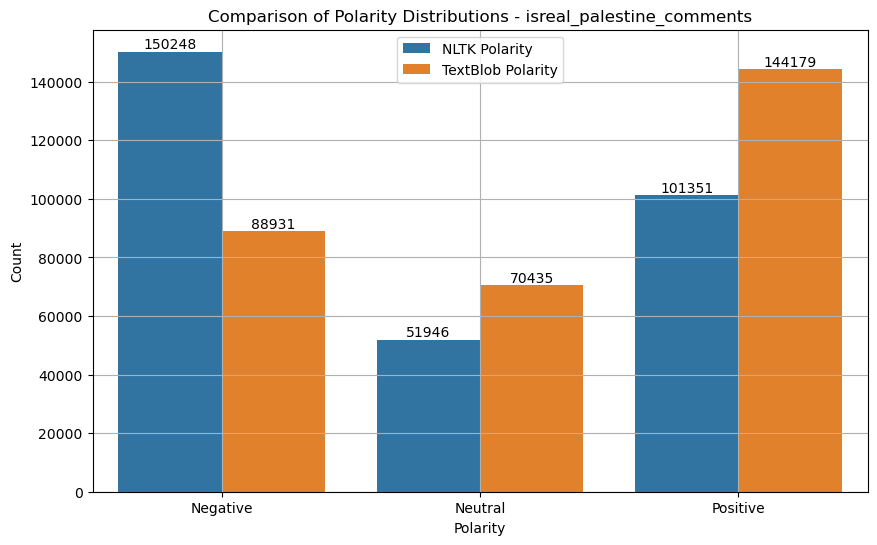

In [79]:
isreal_palestine_comments = pd.read_csv('isreal_palestine_comments.csv')
isreal_palestine_comments_clean = preprocess(isreal_palestine_comments)
isreal_palestine_comments_clean = nltk_polarity(isreal_palestine_comments_clean)
# nltk_score_distribution(isreal_palestine_comments_clean, 'isreal_palestine_comments')
isreal_palestine_comments_clean = textBlob_subjectivity_polarity(isreal_palestine_comments_clean)
polarity_distribution_comparison(isreal_palestine_comments_clean, 'isreal_palestine_comments')

In [78]:
isreal_palestine_comments_clean[isreal_palestine_comments_clean['NLTK Compound Score'] > 0].head(20) # Mostly wrongly classified

,author,body,NLTK Compound Score,NLTK Polarity
2,equilibrium_cause,"Central European here. Before, I was undecided, thinking both were a problem, but with a certain sympathy for Palestine. Well, now the sides are clear to me and I hope that Israel gets rid of Hamas once and for all, even if it gets messy.",0.8820,Positive
4,thesegoupto11,"I was coming of age during the second intifada and learned about Israel and Palestine and became pro-Palestinian. Over the past several years I've been becoming more pro-Israel as I journied from conservative to liberal to socialist. Also prior to this I came out, so this has been a journey for sure. It's incredibly naive to be LGBT and to support an ideology that would murder you the moment they had a chance. I believe the Star Wars effect play into this as well where there is this understanding that if you are a smaller resistance fighting against an empire then you are automatically the underdog and right by default. I want peace. I want a two state solution. I want a free and secure Palestine alongside Israel. But if one side only sees peace as possible so long as the otherside is cleansed from the land... Ultimately what has happened over the past couple days is going to turn many middle of the road types more into the pro-Israel camp.",0.8626,Positive
5,NaN,"I side with Israel because I know I could go to Israel as a gay man, and wouldn't be murdered for how I was born. I can't say the same for Palestine.",0.5448,Positive
15,tingreezy,"Yes, I used to be a raging liberal. I thought the Palestinians were being treated the same way. Us Jews were in Germany. But boy oh boy has my opinion changed. I feel terrible for the everyday citizens of Palestine that just want to live in peace. But they're radical. Hamas is constantly instigating shit like this. Israel is incredibly strong and powerful and rich. I don't know how Hamas thinks that they can possibly win. They're just bringing destruction down on their innocent citizens and it's really sad. The whole thing is just awful",0.8223,Positive
16,Ornery-Society-5570,"I can see why you thought that, palestinians always represented as the victim who just want to live peacefully. The actions took place here are inhumane.",0.3818,Positive
21,Key_Independent1,"Thanks for your support, I truly feel that if people actually research the conflict they will always be pro Israel, I think the fact that r /Palestine still hasn't condemned Hamas but calls it fully justified is proof enough that they aren't good people",0.6892,Positive
23,skbb,"No, I always knew Hamas = Iran/isis/name any barbaric Shia Islamic organisation/country. Time for them to vanish. Good riddence",0.1779,Positive
24,Gravitacijus_1,"Agree, for me was the same",0.3612,Positive
29,thefartingmango,When they finally got to do what they wanted everyone saw their true colors,0.4215,Positive
36,pingpongdingdong1234,"This is Israel's 9/11 moment. 600+ Israelis dead. Parading bodies through the streets as people cheer on. These people are uncivilized savages. If anything it shows that all Israel's security policies have been justified, because they are extremely dangerous. Israel should have every right to occupy the entirety of the region, and enact a total police state. This would be to the benefit of the peaceful Palestinians too. It is clear that they cannot look after themselves, and they cannot manage to run anything, and just devolve into terrorism. **Israel is a huge benefit to the global community.** They are a prosperous nation, delivering technology and innovation to the benefit of the world. **The Palestinians offer nothing to the global community at all except endless pain, misery and destabilization.** Just like the term ""Prussian"" has disappeared from usage, so should the term ""Palestinian"". We can still use the term Palestinian for militarism, aggressiveness and conservatism, but the people who call themselves Palestinians and want peace should dissociate from this identity th

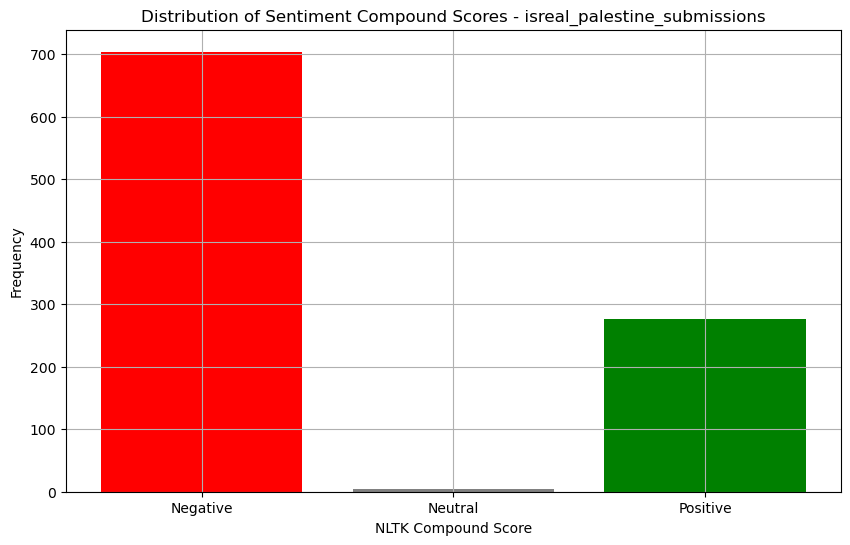

In [36]:
isreal_palestine_submissions = pd.read_csv('isreal_palestine_submissions.csv')
isreal_palestine_submissions_clean = preprocess(isreal_palestine_submissions, text_col='selftext')
isreal_palestine_submissions_clean = nltk_polarity(isreal_palestine_submissions_clean, text_col='selftext')
nltk_score_distribution(isreal_palestine_submissions_clean, 'isreal_palestine_submissions')

In [10]:
sn = SenticNet()
concept_info = sn.concept('i')
# polarity_label = sn.polarity_label('')
# polarity_value = sn.polarity_value('love')
# moodtags = sn.moodtags('love')
# semantics = sn.semantics('love')
# sentics = sn.sentics('love')
print(concept_info)

KeyError: 'i'

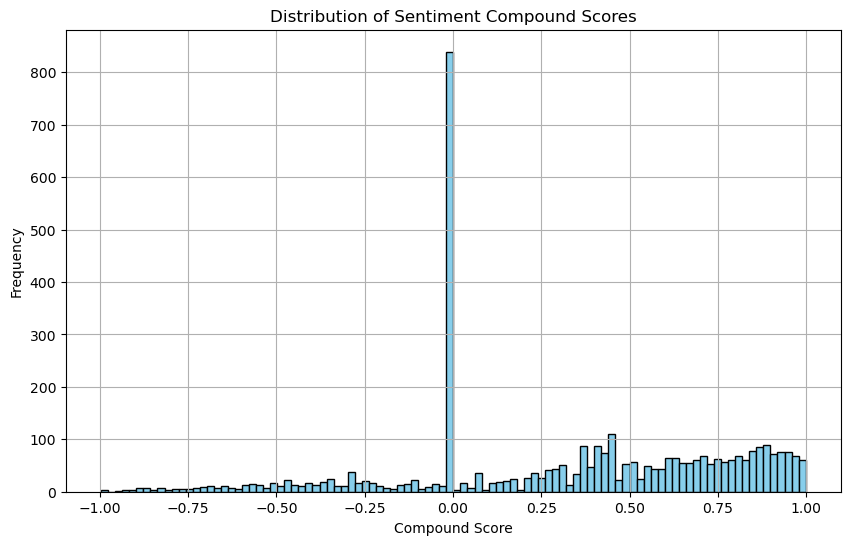

In [31]:
plt.figure(figsize=(10, 6))
hot_ar_comments_clean["Compound Score"].plot(kind='hist', bins=100, color='skyblue', edgecolor='black')
plt.title('Distribution of Sentiment Compound Scores')
plt.xlabel('Compound Score')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()